# Some data augumentation try

In [1]:
%reload_ext autoreload
%autoreload 2
%matplotlib inline

In [2]:
import os
import cv2
from lxml import etree
from matplotlib import pyplot as plt
import random

In [3]:
def get_bound(data_dir):
    '''
    Resume the boundary of the object
    Args:
        data_dir(string): the path of the dataset which stores the pictures and annitations, e.g. 'tiny_simdata/val'
        bboxes(list of directory):[{filename,[xmin, ymin, xmax, ymax]}] 
    '''
    xml_files=os.listdir(os.path.join(data_dir,'Annotations'))
    boundaries = []
    for file in xml_files:
        # becasue I'm using Jupyterlab
        # which always creates the boring file/directory
        if file == '.ipynb_checkpoints':
            continue
        record = {}
        bboxes_xml=[]
        bboxes = []
        tree=etree.parse(os.path.join(data_dir,'Annotations',file))
        root=tree.getroot()
        for c in root.iter():
            if c.tag == 'filename':
                record['filename'] = os.path.join(data_dir,c.text)
            if c.tag=='bndbox':
                bboxes_xml.append(c)
        for bbox in bboxes_xml:
            box=[]
            for b in bbox.iterchildren():
                box.append(int(b.text))
            bboxes.append(box)
        record['bboxes'] = bboxes
        boundaries.append(record)
    return boundaries

In [36]:
def change_bringhtness(boundaries,multiple = None):
    t = 1
    num_img = len(boundaries)
    plt.figure(figsize=(10,10*num_img))
    for anno in boundaries:
        img = cv2.imread(anno['filename'])
        plt.subplot(num_img,2,t)
        plt.imshow(img)
        new_img = img.copy()
        for bbox in anno['bboxes']:
            (xmin, ymin, xmax, ymax) = bbox
            assert xmin<xmax
            assert ymin<ymax
            if not multiple:
                multiple = (random.random()+2)*0.4
            for i in range(ymin,ymax+1):
                for j in range(xmin,xmax+1):
                    (b,g,r) = new_img[i,j]*multiple
                    if int(b)<256 and int(g)<256 and int(r)<256:
                        new_img[i,j] = (b,g,r)
                    else:
                        new_img[i,j] = (255,255,255)
                    if i == ymin or i == ymax or j ==xmin or j==xmax:
                        new_img[i,j] = (255,255,255)
                    new_img[i,j] = new_img[i,j]*multiple
        plt.subplot(num_img,2,t+1)
        plt.imshow(new_img)
        t+=2

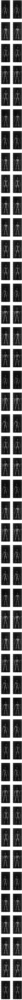

In [37]:
bnds = get_bound('tiny_simdata/val')
change_bringhtness(bnds)

In [54]:
def get_equalize_hist(boundaries):
    t = 1
    num_img = len(boundaries)
    plt.figure(figsize=(10,10*num_img))
    for anno in boundaries:
        img = cv2.imread(anno['filename'])
        plt.subplot(num_img,3,t)
        plt.imshow(img)
        new_img = img.copy()
        for bbox in anno['bboxes']:
            (xmin, ymin, xmax, ymax) = bbox
            assert xmin<xmax
            assert ymin<ymax
            sub_img = img[ymin:ymax, xmin:xmax]
            gray_sub_img = cv2.cvtColor(sub_img,cv2.COLOR_BGR2GRAY)
            equ_sub_img = cv2.equalizeHist(gray_sub_img)
            for i in range(ymin,ymax+1):
                for j in range(xmin,xmax+1):
                    if i == ymin or i == ymax or j ==xmin or j==xmax:
                        new_img[i,j] = (255,255,255)
                    else:
                        new_img[i,j] = equ_sub_img[i-ymin,j-xmin]
        plt.subplot(num_img,3,t+1)
        plt.imshow(new_img)
        gray_img = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
        equ_img = cv2.equalizeHist(gray_img)
        plt.subplot(num_img,3,t+2)
        plt.imshow(equ_img)
        t+=3

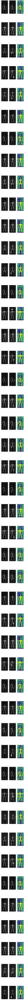

In [55]:
bnds = get_bound('tiny_simdata/val')
get_equalize_hist(bnds)